<a href="https://colab.research.google.com/github/vk18mishra/LSTM-to-predict-Project-Proposal-Acceptance/blob/main/LSTM_on_Donors_Choose.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Model-1

<img src='https://i.imgur.com/w395Yk9.png'>
ref: https://i.imgur.com/w395Yk9.png

### Model-2

<pre>
1. Train the TF-IDF on the Train data <br>
2. Get the idf value for each word we have in the train data. <br>
3. Remove the low idf value and high idf value words from our data. Do some analysis on the Idf values and based on those values choose the low and high threshold value. Because very frequent words and very very rare words don't give much information. (you can plot a box plots and take only the idf scores within IQR range and corresponding words)<br>
4. Train the LSTM after removing the Low and High idf value words. (In model-1 Train on total data but in Model-2 train on data after removing some words based on IDF values)
</pre>

### Model-3

<img src='https://i.imgur.com/fkQ8nGo.png'>
ref: https://i.imgur.com/fkQ8nGo.png


- __input_seq_total_text_data__: <br>
<pre>
    . Use text column('essay'), and use the Embedding layer to get word vectors. <br>
    . Use given predefined glove word vectors, don't train any word vectors. <br>
    . Use LSTM that is given above, get the LSTM output and Flatten that output. <br>
    . You are free to preprocess the input text as you needed. <br>
</pre>
- __Other_than_text_data__:<br>
<pre>
    . Convert all your Categorical values to onehot coded and then concatenate all these onehot vectors <br>
    . Neumerical values and use <a href='https://keras.io/getting-started/sequential-model-guide/#sequence-classification-with-1d-convolutions'>CNN1D</a> as shown in above figure. <br>
    . You are free to choose all CNN parameters like kernel sizes, stride.<br>
    
</pre>

**Importing Libraries**

In [ ]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
import numpy as np
import nltk
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
import re
# Tutorial about Python regular expressions: https://pymotw.com/2/re/
import pickle
from tqdm import tqdm
import os
# !pip install chart_studio
# from chart_studio.plotly import plotly as py
# import plotly.express as px
# import plotly.offline as offline
# import plotly.graph_objs as go
# offline.init_notebook_mode()
from collections import Counter
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV


     |████████████████████████████████| 71kB 3.3MB/s 


In [ ]:
import tensorflow as tf
#enabled to get instant output. if you don't need, you can use session concept which wa
#tf.enable_eager_execution()
from sklearn.model_selection import train_test_split
from tensorflow.keras.layers import Dense,Input,Activation
from tensorflow.keras.models import Model, load_model
import random as rn
import datetime
from sklearn.metrics import roc_auc_score, f1_score
from keras.callbacks import Callback, EarlyStopping
from tensorflow.keras.callbacks import LearningRateScheduler
import logging
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.callbacks import LearningRateScheduler
from keras.callbacks import TerminateOnNaN
from keras.callbacks import LambdaCallback
from keras.layers import Input, Embedding, LSTM, Dropout, BatchNormalization, Dense, concatenate, Flatten, Conv1D, MaxPool1D, LeakyReLU, ELU, SpatialDropout1D, MaxPooling1D, GlobalAveragePooling1D, GlobalMaxPooling1D
from keras.preprocessing.text import Tokenizer, one_hot
from keras import regularizers
from keras.optimizers import *

**Getting Preprocessed Data**

In [ ]:
#source : https://towardsdatascience.com/3-ways-to-load-csv-files-into-colab-7c14fcbdcb
# Code to read csv file into Colaboratory:
!pip install -U -q PyDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials
# Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [ ]:
id = '1SQNaKmaYmkA4HKjox4nm6tmw2tiJIGkn'
id_glove = '1lWuSWW3OsXLmG6Zp2p6zU-N3txJfsKHT'
downloaded = drive.CreateFile({'id':id})
downloaded_glove = drive.CreateFile({'id':id_glove})
downloaded.GetContentFile('preprocessed_data.csv')
data = pd.read_csv('preprocessed_data.csv')
downloaded_glove.GetContentFile('glove_vectors')

# Dataset is now stored in a Pandas Dataframe

In [ ]:
#Getting Resources Data through curlwget
!wget --header="Host: doc-0c-90-docs.googleusercontent.com" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/85.0.4183.102 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/avif,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3;q=0.9" --header="Accept-Language: en-US,en;q=0.9,es;q=0.8" --header="Cookie: AUTH_j9bcrmgt4omen2e6cvbm2ejader83m0d_nonce=l8h26gcfopgqq" --header="Connection: keep-alive" "https://doc-0c-90-docs.googleusercontent.com/docs/securesc/gav8itevci1g4kd0q1cuucl5an9d430s/r6os70e1b7br2ccd25cv9atm5uunmkpn/1600303275000/00484516897554883881/05016653509110039968/1HcuqSNQg60HhHhj8z5neZxkzwE2miwuD?e=download&authuser=0&nonce=l8h26gcfopgqq&user=05016653509110039968&hash=l516vrfec49s0dnaij9tven2u8huu2bg" -c -O 'resources.csv'

--2020-09-17 00:42:19--  https://doc-0c-90-docs.googleusercontent.com/docs/securesc/gav8itevci1g4kd0q1cuucl5an9d430s/r6os70e1b7br2ccd25cv9atm5uunmkpn/1600303275000/00484516897554883881/05016653509110039968/1HcuqSNQg60HhHhj8z5neZxkzwE2miwuD?e=download&authuser=0&nonce=l8h26gcfopgqq&user=05016653509110039968&hash=l516vrfec49s0dnaij9tven2u8huu2bg
Resolving doc-0c-90-docs.googleusercontent.com (doc-0c-90-docs.googleusercontent.com)... 74.125.195.132, 2607:f8b0:400e:c09::84
Connecting to doc-0c-90-docs.googleusercontent.com (doc-0c-90-docs.googleusercontent.com)|74.125.195.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/csv]
Saving to: ‘resources.csv’

resources.csv           [      <=>           ] 121.57M  86.8MB/s    in 1.4s    

2020-09-17 00:42:21 (86.8 MB/s) - ‘resources.csv’ saved [127470958]



In [ ]:
resource_data = pd.read_csv('resources.csv')

In [ ]:
#Getting Raw Data through curlwget
!wget --header="Host: doc-0c-90-docs.googleusercontent.com" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/85.0.4183.102 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/avif,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3;q=0.9" --header="Accept-Language: en-US,en;q=0.9,es;q=0.8" --header="Cookie: AUTH_j9bcrmgt4omen2e6cvbm2ejader83m0d=05016653509110039968|1600303275000|c8ticv6h16jgl5vev5looh2gcn9a7if8" --header="Connection: keep-alive" "https://doc-0c-90-docs.googleusercontent.com/docs/securesc/gav8itevci1g4kd0q1cuucl5an9d430s/vksjsn74iilmll3udj9ps32f49mlmodm/1600303350000/00484516897554883881/05016653509110039968/1QZaaCI5qamo6Qc00LSTfF81e7ZqUcrgH?e=download&authuser=0" -c -O 'train_data.csv'

--2020-09-17 00:43:37--  https://doc-0c-90-docs.googleusercontent.com/docs/securesc/gav8itevci1g4kd0q1cuucl5an9d430s/vksjsn74iilmll3udj9ps32f49mlmodm/1600303350000/00484516897554883881/05016653509110039968/1QZaaCI5qamo6Qc00LSTfF81e7ZqUcrgH?e=download&authuser=0
Resolving doc-0c-90-docs.googleusercontent.com (doc-0c-90-docs.googleusercontent.com)... 74.125.195.132, 2607:f8b0:400e:c09::84
Connecting to doc-0c-90-docs.googleusercontent.com (doc-0c-90-docs.googleusercontent.com)|74.125.195.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/csv]
Saving to: ‘train_data.csv’

train_data.csv          [           <=>      ] 191.64M  68.4MB/s    in 2.8s    

2020-09-17 00:43:41 (68.4 MB/s) - ‘train_data.csv’ saved [200947019]



In [ ]:
raw_data = pd.read_csv('train_data.csv')

**Adding Feature 'Id' from resources dataset to our main Data Frame**

In [ ]:
data.shape

(109248, 9)

In [ ]:
id_data = list(raw_data['id'])
data['id'] = id_data
data.shape

(109248, 10)

**Adding Feature 'Quantity' to our Preprocessed Dataset** 

In [ ]:
price_data = resource_data.groupby('id').agg({'quantity':'sum'}).reset_index()
data = pd.merge(data, price_data, on='id', how='left')
data.shape

(109248, 11)

**Loading Data**

In [ ]:
print(data.shape)
data.head()

(109248, 11)


,school_state,teacher_prefix,project_grade_category,teacher_number_of_previously_posted_projects,project_is_approved,clean_categories,clean_subcategories,essay,price,id,quantity
0,ca,mrs,grades_prek_2,53,1,math_science,appliedsciences health_lifescience,i fortunate enough use fairy tale stem kits cl...,725.05,p253737,23
1,ut,ms,grades_3_5,4,1,specialneeds,specialneeds,imagine 8 9 years old you third grade classroo...,213.03,p258326,1
2,ca,mrs,grades_prek_2,10,1,literacy_language,literacy,having class 24 students comes diverse learner...,329.00,p182444,22
3,ga,mrs,grades_prek_2,2,1,appliedlearning,earlydevelopment,i recently read article giving students choice...,481.04,p246581,4
4,wa,mrs,grades_3_5,2,1,literacy_language,literacy,my students crave challenge eat obstacles brea...,17.74,p104768,4


In [ ]:
# import pandas
# data = data.head(10000)

In [ ]:
print (data.shape)
print (data.head(5))
print (data.columns.values)

(109248, 11)
  school_state teacher_prefix project_grade_category  ...   price       id quantity
0           ca            mrs          grades_prek_2  ...  725.05  p253737       23
1           ut             ms             grades_3_5  ...  213.03  p258326        1
2           ca            mrs          grades_prek_2  ...  329.00  p182444       22
3           ga            mrs          grades_prek_2  ...  481.04  p246581        4
4           wa            mrs             grades_3_5  ...   17.74  p104768        4

[5 rows x 11 columns]
['school_state' 'teacher_prefix' 'project_grade_category'
 'teacher_number_of_previously_posted_projects' 'project_is_approved'
 'clean_categories' 'clean_subcategories' 'essay' 'price' 'id' 'quantity']


<h2>1.2 Splitting data into Train and cross validation(or test): Stratified Sampling</h2>

In [ ]:
# please write all the code with proper documentation, and proper titles for each subsection
# go through documentations and blogs before you start coding
# first figure out what to do, and then think about how to do.
# reading and understanding error messages will be very much helpfull in debugging your code
# when you plot any graph make sure you use 
    # a. Title, that describes your plot, this will be very helpful to the reader
    # b. Legends if needed
    # c. X-axis label
    # d. Y-axis label

# 1.2.1 Separating Class labels from rest of preprocessed data

In [ ]:
y = data['project_is_approved'].values
data = data.drop(['id'], axis=1)
X = data.drop(['project_is_approved'], axis=1)

In [ ]:
# train test split
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, stratify=y)
#X_train, X_cv, y_train, y_cv = train_test_split(X_train, y_train, test_size=0.33, stratify=y_train)

In [ ]:
print (X_train.shape)
print (y_train.shape)
#print (X_cv.shape)
#print (y_cv.shape)
print (X_test.shape)
print (y_test.shape)
#print ("feature names list length = ",len(feature_names))

(81936, 9)
(81936,)
(27312, 9)
(27312,)


In [ ]:
X_train.head()

,school_state,teacher_prefix,project_grade_category,teacher_number_of_previously_posted_projects,clean_categories,clean_subcategories,essay,price,quantity
59672,oh,mrs,grades_prek_2,2,literacy_language,literacy,my students come different kinds backgrounds s...,504.47,1
57026,ca,ms,grades_3_5,7,music_arts,music performingarts,when asked music means student told music make...,5.50,5
9296,nj,mrs,grades_prek_2,2,literacy_language,literacy,kindergarten truly amazing year my students sh...,199.00,6
26227,az,mr,grades_prek_2,2,literacy_language math_science,literacy mathematics,this year i opportunity work 36 amazing studen...,605.22,12
53554,ca,mrs,grades_3_5,56,math_science,environmentalscience,i wonderful group 5th grade students highly mo...,450.64,3


# Model 1

<h2>1.3 Make Data Model Ready: encoding eassay, and project_title</h2>

In [ ]:
# please write all the code with proper documentation, and proper titles for each subsection
# go through documentations and blogs before you start coding
# first figure out what to do, and then think about how to do.
# reading and understanding error messages will be very much helpfull in debugging your code
# make sure you featurize train and test data separatly

# when you plot any graph make sure you use 
    # a. Title, that describes your plot, this will be very helpful to the reader
    # b. Legends if needed
    # c. X-axis label
    # d. Y-axis label

## Encoding Text Data - Essay

In [ ]:
#tokenizer keras : https://stackoverflow.com/a/51956230
from keras.preprocessing.text import Tokenizer
tokenizer = Tokenizer()
tokenizer.fit_on_texts(X_train["essay"].tolist())
seq_train = tokenizer.texts_to_sequences(X_train["essay"])
seq_test = tokenizer.texts_to_sequences(X_test["essay"])

In [ ]:
#https://learn-neural-networks.com/world-embedding-by-keras/
vocab_size = len(tokenizer.word_index) + 1
vocab_size

50299

In [ ]:
#Post Padding to make the input to the fisrt layer of same length
from keras.preprocessing.sequence import pad_sequences
padded_train = pad_sequences(seq_train,maxlen=800,padding='post', truncating='post')
padded_test = pad_sequences(seq_test, maxlen=800,padding='post', truncating='post')

In [ ]:
glove_vector = open("/content/glove_vectors","rb")
glove_vectors = pickle.load(glove_vector)

In [ ]:
embedding_matrix = np.zeros((vocab_size, 300))
for word, i in tokenizer.word_index.items():
    embedding_vector = glove_vectors.get(word)
    if embedding_vector is not None:
        embedding_matrix[i] = embedding_vector

In [ ]:
embedding_matrix.shape

(50299, 300)

# 1.4.1 encoding categorical features: School State

In [ ]:
from sklearn.preprocessing import LabelEncoder
lab_enc = LabelEncoder()
enc_state_train = lab_enc.fit_transform(X_train["school_state"])
X_test["school_state"] = X_test["school_state"].map(lambda s: ' ' if s not in lab_enc.classes_ else s)
lab_enc.classes_ = np.append(lab_enc.classes_, ' ')
enc_state_test = lab_enc.transform(X_test["school_state"])

print("After vectorizations")
print(enc_state_train.shape, y_train.shape)
#print(X_cv_teacher_ohe.shape, y_cv.shape)
print(enc_state_test.shape, y_test.shape)
# print(vectorizer.get_feature_names())
print("="*100)

After vectorizations
(81936,) (81936,)
(27312,) (27312,)


# 1.4.2 encoding categorical features: teacher_prefix

In [ ]:
lab_enc = LabelEncoder()
enc_prefix_train = lab_enc.fit_transform(X_train["teacher_prefix"])
X_test["teacher_prefix"] = X_test["teacher_prefix"].map(lambda s: ' ' if s not in lab_enc.classes_ else s)
lab_enc.classes_ = np.append(lab_enc.classes_, ' ')
enc_prefix_test = lab_enc.transform(X_test["teacher_prefix"])

print("After vectorizations")
print(enc_prefix_train.shape, y_train.shape)
#print(X_cv_teacher_ohe.shape, y_cv.shape)
print(enc_prefix_test.shape, y_test.shape)
# print(vectorizer.get_feature_names())
print("="*100)

After vectorizations
(81936,) (81936,)
(27312,) (27312,)


# 1.4.3 encoding categorical features: project_grade_category

In [ ]:
lab_enc = LabelEncoder()
enc_grade_train = lab_enc.fit_transform(X_train["project_grade_category"])
X_test["project_grade_category"] = X_test["project_grade_category"].map(lambda s: ' ' if s not in lab_enc.classes_ else s)
lab_enc.classes_ = np.append(lab_enc.classes_, ' ')
enc_grade_test = lab_enc.transform(X_test["project_grade_category"])

print("After vectorizations")
print(enc_grade_train.shape, y_train.shape)
#print(X_cv_teacher_ohe.shape, y_cv.shape)
print(enc_grade_test.shape, y_test.shape)
# print(vectorizer.get_feature_names())
print("="*100)

After vectorizations
(81936,) (81936,)
(27312,) (27312,)


# 1.4.4 encoding categorical features: clean_categories

In [ ]:
from sklearn.preprocessing import LabelEncoder
lab_enc = LabelEncoder()
enc_cat_train = lab_enc.fit_transform(X_train["clean_categories"])
X_test["clean_categories"] = X_test["clean_categories"].map(lambda s: ' ' if s not in lab_enc.classes_ else s)
lab_enc.classes_ = np.append(lab_enc.classes_, ' ')
enc_cat_test= lab_enc.transform(X_test["clean_categories"])

print("After vectorizations")
print(enc_cat_train.shape, y_train.shape)
print(enc_cat_test.shape, y_test.shape)
print("="*100)

After vectorizations
(81936,) (81936,)
(27312,) (27312,)


# 1.4.5 encoding categorical features: clean_subcategories

In [ ]:
from sklearn.preprocessing import LabelEncoder
lab_enc = LabelEncoder()
enc_subcat_train = lab_enc.fit_transform(X_train["clean_subcategories"])
X_test["clean_subcategories"] = X_test["clean_subcategories"].map(lambda s: ' ' if s not in lab_enc.classes_ else s)
lab_enc.classes_ = np.append(lab_enc.classes_, ' ')
enc_subcat_test= lab_enc.transform(X_test["clean_subcategories"])

print("After vectorizations")
print(enc_subcat_train.shape, y_train.shape)
print(enc_subcat_test.shape, y_test.shape)
print("="*100)

After vectorizations
(81936,) (81936,)
(27312,) (27312,)


# 1.4.6 encoding numerical features: Price

In [ ]:
#Taken from 5_Reference_SampleSolution.ipynb

from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X_train['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['price'].values.reshape(1,-1))

X_train_price_norm = normalizer.transform(X_train['price'].values.reshape(1,-1))
#X_cv_price_norm = normalizer.transform(X_cv['price'].values.reshape(1,-1))
X_test_price_norm = normalizer.transform(X_test['price'].values.reshape(1,-1))

X_train_price_norm = X_train_price_norm.reshape(-1,1)
#X_cv_price_norm = X_cv_price_norm.reshape(-1,1)
X_test_price_norm = X_test_price_norm.reshape(-1,1)

print("After vectorizations")
print(X_train_price_norm.shape, y_train.shape)
#print(X_cv_price_norm.shape, y_cv.shape)
print(X_test_price_norm.shape, y_test.shape)
print("="*100)

# #Storing feature names in a list
# feature_names.append('Numerical_R_Price')
# print ("feature names list length = ",len(feature_names))
# #print ("\nHere :",(feature_names))

print("="*100)
#printing price after normalization
print(X_train_price_norm[0:10])

After vectorizations
(81936, 1) (81936,)
(27312, 1) (27312,)
[[3.76078598e-03]
 [6.00179109e-04]
 [2.84118423e-03]
 [2.21161586e-05]
 [1.14313822e-03]
 [9.27394355e-04]
 [1.27227284e-03]
 [3.38236218e-03]
 [2.64800181e-04]
 [8.70990729e-04]]


# 1.4.7 encoding numerical features: teacher_number_of_previously_posted_projects

In [ ]:
#Referred from 5_Reference_SampleSolution.ipynb

from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X_train['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))

X_train_prevProjects_norm = normalizer.transform(X_train['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))
#X_cv_prevProjects_norm = normalizer.transform(X_cv['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))
X_test_prevProjects_norm = normalizer.transform(X_test['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))

X_train_prevProjects_norm = X_train_prevProjects_norm.reshape(-1,1)
#X_cv_prevProjects_norm = X_cv_prevProjects_norm.reshape(-1,1)
X_test_prevProjects_norm = X_test_prevProjects_norm.reshape(-1,1)

print("After vectorizations")
print(X_train_prevProjects_norm.shape, y_train.shape)
#print(X_cv_prevProjects_norm.shape, y_cv.shape)
print(X_test_prevProjects_norm.shape, y_test.shape)
print("="*100)

# #Storing feature names in a list
# feature_names.append('Numerical_Prev_Projects')
# print ("feature names list length = ",len(feature_names))
# #print ("\nHere :",(feature_names))

print("="*100)
#printing prevProjects after normalization
print(X_train_prevProjects_norm[0:10])

After vectorizations
(81936, 1) (81936,)
(27312, 1) (27312,)
[[0.00069415]
 [0.        ]
 [0.00277661]
 [0.00416491]
 [0.00011569]
 [0.00011569]
 [0.        ]
 [0.00254522]
 [0.00023138]
 [0.00196676]]


# 1.4.7 encoding numerical features: quantity

In [ ]:
#Referred from 5_Reference_SampleSolution.ipynb

from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X_train['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['quantity'].values.reshape(1,-1))

X_train_quantity_norm = normalizer.transform(X_train['quantity'].values.reshape(1,-1))
#X_cv_prevProjects_norm = normalizer.transform(X_cv['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))
X_test_quantity_norm = normalizer.transform(X_test['quantity'].values.reshape(1,-1))

X_train_quantity_norm = X_train_quantity_norm.reshape(-1,1)
#X_cv_prevProjects_norm = X_cv_prevProjects_norm.reshape(-1,1)
X_test_quantity_norm = X_test_quantity_norm.reshape(-1,1)

print("After vectorizations")
print(X_train_quantity_norm.shape, y_train.shape)
#print(X_cv_prevProjects_norm.shape, y_cv.shape)
print(X_test_quantity_norm.shape, y_test.shape)
print("="*100)

# #Storing feature names in a list
# feature_names.append('Numerical_Prev_Projects')
# print ("feature names list length = ",len(feature_names))
# #print ("\nHere :",(feature_names))

print("="*100)
#printing prevProjects after normalization
print(X_train_quantity_norm[0:10])

After vectorizations
(81936, 1) (81936,)
(27312, 1) (27312,)
[[0.00033578]
 [0.00111928]
 [0.00279821]
 [0.00167892]
 [0.00302206]
 [0.00022386]
 [0.00055964]
 [0.00246242]
 [0.00044771]
 [0.00839462]]


### **LSTM Connection for Text Data**

In [ ]:
#Source: https://github.com/vishnurapps/LSTM-on-Donors-Choose

In [ ]:
#https://stats.stackexchange.com/a/305032
input_text = Input(shape=(800,),name="input_text")
embed_out = Embedding(vocab_size,300,weights=[embedding_matrix],input_length=800,trainable=False)(input_text)
lstm_out = LSTM(128,recurrent_dropout=0.5,kernel_regularizer=regularizers.l2(0.001),return_sequences=True)(embed_out)
flat_out = Flatten()(lstm_out)

### **Teacher Prefix - Connection**

In [ ]:
no_of_unique_prefix  = X_train["teacher_prefix"].nunique()
embed_size_prefix = int(min(np.ceil((no_of_unique_prefix)/2), 50 ))

input_teacher_prefix = Input(shape=(1,),name="teacher_prefix")
embed_teacher_prefix_out = Embedding(no_of_unique_prefix, embed_size_prefix, trainable=True, name="embedded_teacher_prefix")(input_teacher_prefix)
flat_teacher_prefix_out = Flatten()(embed_teacher_prefix_out)

In [ ]:
no_of_unique_prefix

5

### **School State - Connection**

In [ ]:
no_of_unique_state  = X_train["school_state"].nunique()
embed_size_state= int(min(np.ceil((no_of_unique_state)/2), 50 ))

input_school_state = Input(shape=(1,),name="school_prefix")
embed_school_state_out = Embedding(no_of_unique_state, embed_size_state, name="embedded_school_state",trainable=True)(input_school_state)
flat_school_state_out = Flatten()(embed_school_state_out)

In [ ]:
no_of_unique_state

51

### **Project Grade Category - Connnection**

In [ ]:
no_of_unique_grade  = X_train["project_grade_category"].nunique()
embed_size_grade = int(min(np.ceil((no_of_unique_grade)/2), 50 ))

input_project_grade_category = Input(shape=(1,), name="project_grade_category")
embed_project_grade_category_out = Embedding(no_of_unique_grade, embed_size_grade, name="embedded_project_grade_category", trainable=True)(input_project_grade_category)
flat_project_grade_category_out = Flatten()(embed_project_grade_category_out)

In [ ]:
no_of_unique_grade

4

### **Project Categories - Connection**

In [ ]:
no_of_unique_subcat  = X_train["clean_categories"].nunique()+1
embed_size_subcat = int(min(np.ceil((no_of_unique_subcat)/2), 50 ))

input_categories= Input(shape=(1,),name="clean_categories")
embed_categories_out = Embedding(no_of_unique_subcat,embed_size_subcat,name="embedded_clean_categories",trainable=True)(input_categories)
flat_categories_out = Flatten()(embed_categories_out)

In [ ]:
no_of_unique_subcat

52

### **Project Sub-categories - Connection**

In [ ]:
no_of_unique_subcat_1  = X_train["clean_subcategories"].nunique()+1
embed_size_subcat_1 = int(min(np.ceil((no_of_unique_subcat_1)/2), 50 ))

input_subcategories = Input(shape=(1,),name="clean_subcategories")
embed_subcategories_out = Embedding(no_of_unique_subcat_1,embed_size_subcat_1,name="embedded_subcategories",trainable=True)(input_subcategories)
flat_subcategories_out = Flatten()(embed_subcategories_out)

In [ ]:
no_of_unique_subcat_1

395

### **Numerical Features - Quantity, Prev. Projects, & Price**

### *Cocatenating Numerical Features*

In [ ]:
numerical_train = np.concatenate((X_train_price_norm,X_train_quantity_norm,X_train_prevProjects_norm),axis=1)
numerical_test = np.concatenate((X_test_price_norm,X_test_quantity_norm,X_test_prevProjects_norm),axis=1)

from sklearn.preprocessing import StandardScaler
Std_Scale = StandardScaler()
normal_train = Std_Scale.fit_transform(numerical_train)
normal_test = Std_Scale.transform(numerical_test)

In [ ]:
numerical_out = Input(shape=(3,),name="numerical_features")
numerical_dense_out = Dense(100,activation="relu",kernel_initializer="he_normal",kernel_regularizer=regularizers.l2(0.001))(numerical_out)

## Model 1 - Connecting all the layers, fitting and running the model

In [ ]:
concat_out = concatenate([flat_out,flat_teacher_prefix_out, flat_school_state_out ,flat_project_grade_category_out, flat_categories_out, flat_subcategories_out,numerical_dense_out])
dense_128_out = Dense(128,activation="relu", kernel_initializer="he_normal",kernel_regularizer=regularizers.l2(0.001))(concat_out)
first_drop_out = Dropout(0.5)(dense_128_out)
dense_256_out = Dense(256,activation="relu",kernel_initializer="he_normal",kernel_regularizer=regularizers.l2(0.001))(first_drop_out)
second_drop_out = Dropout(0.5)(dense_256_out)
dense_64_out = Dense(64,activation="relu", kernel_initializer="he_normal",kernel_regularizer=regularizers.l2(0.001))(second_drop_out)
#batch_out = BatchNormalization()(dense_64_out)
output = Dense(2, activation='softmax', name='output')(dense_64_out)
model_1 = Model(inputs=[input_text, input_teacher_prefix, input_school_state, input_project_grade_category, input_categories, input_subcategories, numerical_out],outputs=[output])

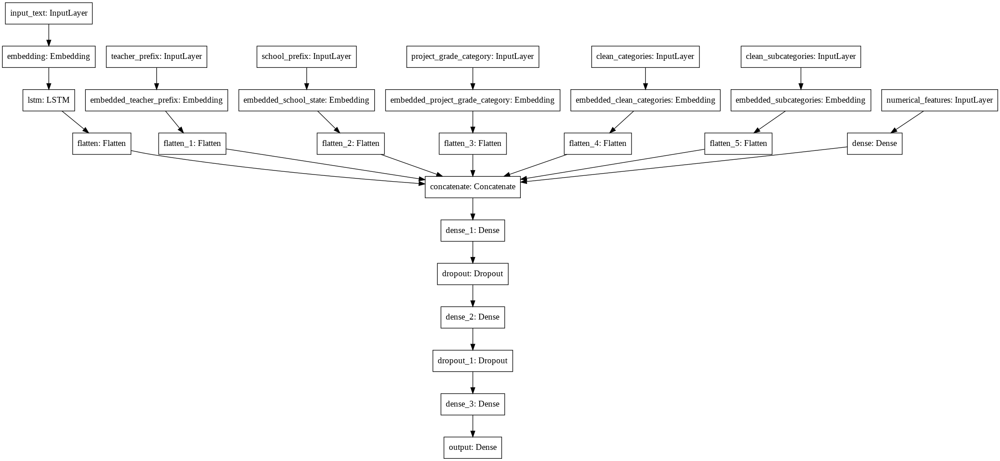

In [ ]:
#drawing models
tf.keras.utils.plot_model(
    model_1,
    show_shapes=False,
    show_layer_names=True,
    rankdir='TB',
    expand_nested=False,
    dpi=96
)

In [ ]:
#model_1.summary()

In [ ]:
train_data_1 = [padded_train,enc_prefix_train,enc_state_train,enc_grade_train,enc_cat_train,enc_subcat_train,normal_train]
test_data_1 = [padded_test,enc_prefix_test,enc_state_test,enc_grade_test,enc_cat_test,enc_subcat_test,normal_test]

In [ ]:
from keras.utils import np_utils
Y_train = np_utils.to_categorical(y_train, 2) 
Y_test = np_utils.to_categorical(y_test, 2)

In [ ]:
def auroc(y_true, y_pred):
  try:
    return tf.py_function(roc_auc_score, (y_true, y_pred), tf.double)
  except ValueError:
    pass

In [ ]:
model_1.compile(optimizer=Adam(lr=0.001), loss='categorical_crossentropy', metrics=[auroc])

In [ ]:
!pip install tensorboardcolab
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
!rm -rf ./logs/

In [ ]:
from keras.callbacks import TensorBoard

In [ ]:
checkpoint_1 = ModelCheckpoint("model_1.h5",monitor="val_auroc",mode="max",save_best_only = True,verbose=1)
NAME = 'model_1'
tensorboard_1 = TensorBoard(log_dir='logsv\{}'.format(NAME),update_freq='epoch')
earlystop = EarlyStopping(monitor='val_auroc', min_delta=0, patience=2, verbose=1, mode='max')

# logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
# tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
# print(logdir)

callbacks_1 = [tensorboard_1, checkpoint_1, earlystop]

In [ ]:
history_1 = model_1.fit(train_data_1,Y_train,batch_size=512,epochs=20,validation_data=(test_data_1,Y_test),verbose=1, callbacks=callbacks_1)

Epoch 1/20
161/161 [==============================] - ETA: 0s - loss: 0.4910 - auroc: 0.7467
Epoch 00001: val_auroc improved from -inf to 0.75152, saving model to model_1.h5
161/161 [==============================] - 448s 3s/step - loss: 0.4910 - auroc: 0.7467 - val_loss: 0.4532 - val_auroc: 0.7515
Epoch 2/20
161/161 [==============================] - ETA: 0s - loss: 0.4429 - auroc: 0.7533
Epoch 00002: val_auroc improved from 0.75152 to 0.75517, saving model to model_1.h5
161/161 [==============================] - 430s 3s/step - loss: 0.4429 - auroc: 0.7533 - val_loss: 0.4241 - val_auroc: 0.7552
Epoch 3/20
161/161 [==============================] - ETA: 0s - loss: 0.4193 - auroc: 0.7548
Epoch 00003: val_auroc improved from 0.75517 to 0.75645, saving model to model_1.h5
161/161 [==============================] - 429s 3s/step - loss: 0.4193 - auroc: 0.7548 - val_loss: 0.4128 - val_auroc: 0.7565
Epoch 4/20
161/161 [==============================] - ETA: 0s - loss: 0.4109 - auroc: 0.7537
E

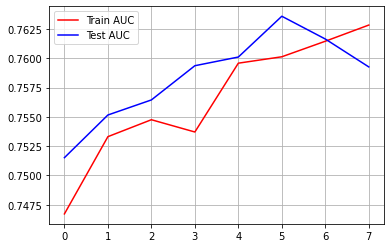

In [ ]:
plt.plot(history_1.history['auroc'], 'r')
plt.plot(history_1.history['val_auroc'], 'b')
plt.legend({'Train AUC': 'r', 'Test AUC':'b'})
plt.grid()
plt.show()

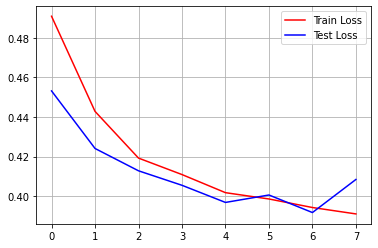

In [ ]:
plt.plot(history_1.history['loss'], 'r')
plt.plot(history_1.history['val_loss'], 'b')
plt.legend({'Train Loss': 'r', 'Test Loss':'b'})
plt.grid()
plt.show()

In [ ]:
!ls

 adc.json	  model_1.h5		  resources.csv
 glove_vectors	  model.png		  sample_data
'logsv\model_1'   preprocessed_data.csv   train_data.csv


In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
NAME = model_1
%tensorboard --logdir='/content/logsv\model_1/'

Reusing TensorBoard on port 6006 (pid 1650), started 0:01:04 ago. (Use '!kill 1650' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
!kill 1650

### Model 1 - Plots

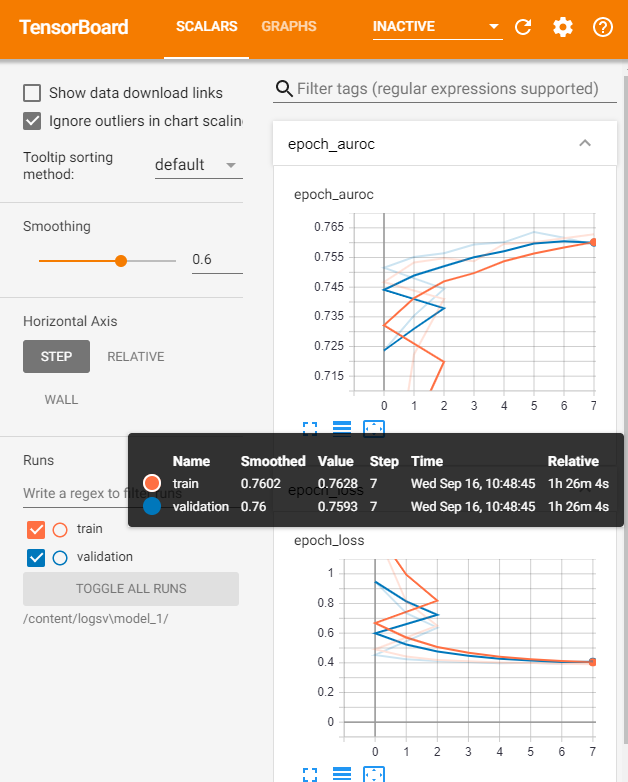

# Model 2

### Getting words with normal IDF values

In [ ]:
vectorizer = TfidfVectorizer()
vectorizer.fit_transform(X_train["essay"])
wordList = list(vectorizer.get_feature_names())
idfValues = list(vectorizer.idf_)
len(wordList), len(idfValues)

(50325, 50325)

In [ ]:
df_idf = pd.DataFrame()
df_idf['words'] = wordList
df_idf['idf'] = idfValues
df_idf = df_idf.sort_values(by ='idf' )
print(df_idf.shape)
df_idf.head()

(50325, 2)


,words,idf
43050,students,1.007755
30012,nannan,1.045671
39236,school,1.160173
29903,my,1.247114
25960,learning,1.365341


**Box and Viloin Plot of IDF Values - Before Removal**

Text(0.5, 0, 'IDF Values')

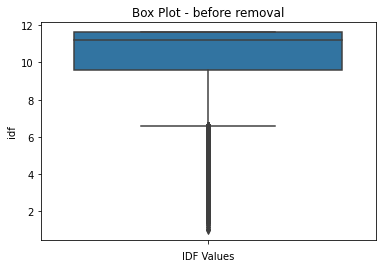

In [ ]:
sns.boxplot(x = "idf",data=df_idf,orient="v")
plt.title("Box Plot - before removal")
plt.xlabel("IDF Values")

Text(0.5, 0, 'IDF Values')

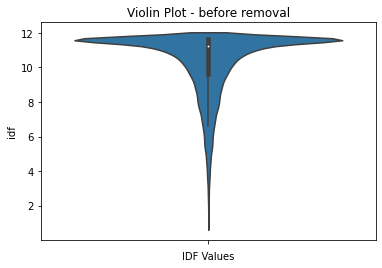

In [ ]:
sns.violinplot(x = "idf",data=df_idf,orient="v")
plt.title("Violin Plot - before removal")
plt.xlabel("IDF Values")

**Annalysing Quantiles**

In [ ]:
quantiles = list(np.percentile(df_idf['idf'],np.arange(0, 100, 25)))
vals = list(np.arange(0, 100, 25))
for i in range(4):
  print(vals[i],"th Percentile Value: ",quantiles[i])

0 th Percentile Value:  1.007755443457783
25 th Percentile Value:  9.605655737173175
50 th Percentile Value:  11.215093649607276
75 th Percentile Value:  11.62055875771544


**Keeping Words with IDF Values in between 1 to 30th Percentile** 

In [ ]:
df_idf_new = df_idf[(df_idf["idf"] >=  np.percentile(df_idf["idf"],1)) & (df_idf["idf"] <=  np.percentile(df_idf["idf"],30))]
df_idf_new.shape

(15013, 2)

**Box and Violin Plots - After Removal**

Text(0.5, 0, 'IDF Values')

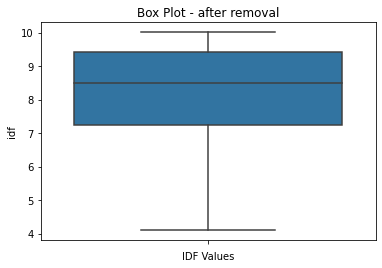

In [ ]:
sns.boxplot(x = "idf",data=df_idf_new,orient="v")
plt.title("Box Plot - after removal")
plt.xlabel("IDF Values")

Text(0.5, 0, 'IDF Values')

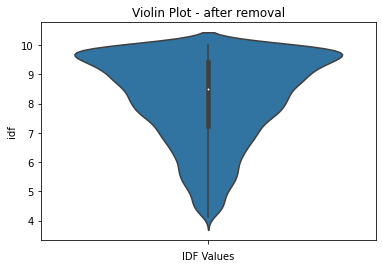

In [ ]:
sns.violinplot(x = "idf",data=df_idf_new,orient="v")
plt.title("Violin Plot - after removal")
plt.xlabel("IDF Values")

In [ ]:
words_refined = df_idf_new["words"].tolist()

## Encoding Text Data - Essay

In [ ]:
#tokenizer keras : https://stackoverflow.com/a/51956230
from keras.preprocessing.text import Tokenizer
tokenizer = Tokenizer()
tokenizer.fit_on_texts(words_refined)
seq_train = tokenizer.texts_to_sequences(X_train["essay"])
seq_test = tokenizer.texts_to_sequences(X_test["essay"])

In [ ]:
#https://learn-neural-networks.com/world-embedding-by-keras/
vocab_size = len(tokenizer.word_index) + 1
vocab_size

15014

In [ ]:
#Post Padding to make the input to the fisrt layer of same length
from keras.preprocessing.sequence import pad_sequences
padded_train = pad_sequences(seq_train,maxlen=800,padding='post', truncating='post')
padded_test = pad_sequences(seq_test, maxlen=800,padding='post', truncating='post')

In [ ]:
glove_vector = open("/content/glove_vectors","rb")
glove_vectors = pickle.load(glove_vector)

In [ ]:
embedding_matrix = np.zeros((vocab_size, 300))
for word, i in tokenizer.word_index.items():
    embedding_vector = glove_vectors.get(word)
    if embedding_vector is not None:
        embedding_matrix[i] = embedding_vector

In [ ]:
embedding_matrix.shape

(15014, 300)

# 1.4.1 encoding categorical features: School State

In [ ]:
from sklearn.preprocessing import LabelEncoder
lab_enc = LabelEncoder()
enc_state_train = lab_enc.fit_transform(X_train["school_state"])
X_test["school_state"] = X_test["school_state"].map(lambda s: ' ' if s not in lab_enc.classes_ else s)
lab_enc.classes_ = np.append(lab_enc.classes_, ' ')
enc_state_test = lab_enc.transform(X_test["school_state"])

print("After vectorizations")
print(enc_state_train.shape, y_train.shape)
#print(X_cv_teacher_ohe.shape, y_cv.shape)
print(enc_state_test.shape, y_test.shape)
# print(vectorizer.get_feature_names())
print("="*100)

After vectorizations
(81936,) (81936,)
(27312,) (27312,)


# 1.4.2 encoding categorical features: teacher_prefix

In [ ]:
lab_enc = LabelEncoder()
enc_prefix_train = lab_enc.fit_transform(X_train["teacher_prefix"])
X_test["teacher_prefix"] = X_test["teacher_prefix"].map(lambda s: ' ' if s not in lab_enc.classes_ else s)
lab_enc.classes_ = np.append(lab_enc.classes_, ' ')
enc_prefix_test = lab_enc.transform(X_test["teacher_prefix"])

print("After vectorizations")
print(enc_prefix_train.shape, y_train.shape)
#print(X_cv_teacher_ohe.shape, y_cv.shape)
print(enc_prefix_test.shape, y_test.shape)
# print(vectorizer.get_feature_names())
print("="*100)

After vectorizations
(81936,) (81936,)
(27312,) (27312,)


# 1.4.3 encoding categorical features: project_grade_category

In [ ]:
lab_enc = LabelEncoder()
enc_grade_train = lab_enc.fit_transform(X_train["project_grade_category"])
X_test["project_grade_category"] = X_test["project_grade_category"].map(lambda s: ' ' if s not in lab_enc.classes_ else s)
lab_enc.classes_ = np.append(lab_enc.classes_, ' ')
enc_grade_test = lab_enc.transform(X_test["project_grade_category"])

print("After vectorizations")
print(enc_grade_train.shape, y_train.shape)
#print(X_cv_teacher_ohe.shape, y_cv.shape)
print(enc_grade_test.shape, y_test.shape)
# print(vectorizer.get_feature_names())
print("="*100)

After vectorizations
(81936,) (81936,)
(27312,) (27312,)


# 1.4.4 encoding categorical features: clean_categories

In [ ]:
from sklearn.preprocessing import LabelEncoder
lab_enc = LabelEncoder()
enc_cat_train = lab_enc.fit_transform(X_train["clean_categories"])
X_test["clean_categories"] = X_test["clean_categories"].map(lambda s: ' ' if s not in lab_enc.classes_ else s)
lab_enc.classes_ = np.append(lab_enc.classes_, ' ')
enc_cat_test= lab_enc.transform(X_test["clean_categories"])

print("After vectorizations")
print(enc_cat_train.shape, y_train.shape)
print(enc_cat_test.shape, y_test.shape)
print("="*100)

After vectorizations
(81936,) (81936,)
(27312,) (27312,)


# 1.4.5 encoding categorical features: clean_subcategories

In [ ]:
from sklearn.preprocessing import LabelEncoder
lab_enc = LabelEncoder()
enc_subcat_train = lab_enc.fit_transform(X_train["clean_subcategories"])
X_test["clean_subcategories"] = X_test["clean_subcategories"].map(lambda s: ' ' if s not in lab_enc.classes_ else s)
lab_enc.classes_ = np.append(lab_enc.classes_, ' ')
enc_subcat_test= lab_enc.transform(X_test["clean_subcategories"])

print("After vectorizations")
print(enc_subcat_train.shape, y_train.shape)
print(enc_subcat_test.shape, y_test.shape)
print("="*100)

After vectorizations
(81936,) (81936,)
(27312,) (27312,)


# 1.4.6 encoding numerical features: Price

In [ ]:
#Taken from 5_Reference_SampleSolution.ipynb

from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X_train['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['price'].values.reshape(1,-1))

X_train_price_norm = normalizer.transform(X_train['price'].values.reshape(1,-1))
#X_cv_price_norm = normalizer.transform(X_cv['price'].values.reshape(1,-1))
X_test_price_norm = normalizer.transform(X_test['price'].values.reshape(1,-1))

X_train_price_norm = X_train_price_norm.reshape(-1,1)
#X_cv_price_norm = X_cv_price_norm.reshape(-1,1)
X_test_price_norm = X_test_price_norm.reshape(-1,1)

print("After vectorizations")
print(X_train_price_norm.shape, y_train.shape)
#print(X_cv_price_norm.shape, y_cv.shape)
print(X_test_price_norm.shape, y_test.shape)
print("="*100)

# #Storing feature names in a list
# feature_names.append('Numerical_R_Price')
# print ("feature names list length = ",len(feature_names))
# #print ("\nHere :",(feature_names))

print("="*100)
#printing price after normalization
print(X_train_price_norm[0:10])

After vectorizations
(81936, 1) (81936,)
(27312, 1) (27312,)
[[2.06616219e-03]
 [1.27731504e-03]
 [9.53174882e-04]
 [8.77895015e-05]
 [8.77820993e-04]
 [2.20843152e-03]
 [1.47598875e-03]
 [1.36828747e-03]
 [2.72976495e-03]
 [4.99719161e-04]]


# 1.4.7 encoding numerical features: teacher_number_of_previously_posted_projects

In [ ]:
#Referred from 5_Reference_SampleSolution.ipynb

from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X_train['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))

X_train_prevProjects_norm = normalizer.transform(X_train['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))
#X_cv_prevProjects_norm = normalizer.transform(X_cv['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))
X_test_prevProjects_norm = normalizer.transform(X_test['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))

X_train_prevProjects_norm = X_train_prevProjects_norm.reshape(-1,1)
#X_cv_prevProjects_norm = X_cv_prevProjects_norm.reshape(-1,1)
X_test_prevProjects_norm = X_test_prevProjects_norm.reshape(-1,1)

print("After vectorizations")
print(X_train_prevProjects_norm.shape, y_train.shape)
#print(X_cv_prevProjects_norm.shape, y_cv.shape)
print(X_test_prevProjects_norm.shape, y_test.shape)
print("="*100)

# #Storing feature names in a list
# feature_names.append('Numerical_Prev_Projects')
# print ("feature names list length = ",len(feature_names))
# #print ("\nHere :",(feature_names))

print("="*100)
#printing prevProjects after normalization
print(X_train_prevProjects_norm[0:10])

After vectorizations
(81936, 1) (81936,)
(27312, 1) (27312,)
[[0.00011621]
 [0.00011621]
 [0.00011621]
 [0.        ]
 [0.00302158]
 [0.00023243]
 [0.00116215]
 [0.00174322]
 [0.        ]
 [0.00011621]]


# 1.4.7 encoding numerical features: quantity

In [ ]:
#Referred from 5_Reference_SampleSolution.ipynb

from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X_train['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['quantity'].values.reshape(1,-1))

X_train_quantity_norm = normalizer.transform(X_train['quantity'].values.reshape(1,-1))
#X_cv_prevProjects_norm = normalizer.transform(X_cv['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))
X_test_quantity_norm = normalizer.transform(X_test['quantity'].values.reshape(1,-1))

X_train_quantity_norm = X_train_quantity_norm.reshape(-1,1)
#X_cv_prevProjects_norm = X_cv_prevProjects_norm.reshape(-1,1)
X_test_quantity_norm = X_test_quantity_norm.reshape(-1,1)

print("After vectorizations")
print(X_train_quantity_norm.shape, y_train.shape)
#print(X_cv_prevProjects_norm.shape, y_cv.shape)
print(X_test_quantity_norm.shape, y_test.shape)
print("="*100)

# #Storing feature names in a list
# feature_names.append('Numerical_Prev_Projects')
# print ("feature names list length = ",len(feature_names))
# #print ("\nHere :",(feature_names))

print("="*100)
#printing prevProjects after normalization
print(X_train_quantity_norm[0:10])

After vectorizations
(81936, 1) (81936,)
(27312, 1) (27312,)
[[0.00011204]
 [0.00089632]
 [0.00033612]
 [0.00179264]
 [0.0011204 ]
 [0.00022408]
 [0.00134448]
 [0.00224079]
 [0.00067224]
 [0.00100836]]


**LSTM model for Text Data**

In [ ]:
#Source: https://github.com/vishnurapps/LSTM-on-Donors-Choose

In [ ]:
#https://stats.stackexchange.com/a/305032
embedding_layer = Embedding(vocab_size,300,weights=[embedding_matrix],input_length=800,trainable=False)
input_text = Input(shape=(800,),name="input_text")
embed_out = embedding_layer(input_text)
lstm_out = LSTM(128,recurrent_dropout=0.5,kernel_regularizer=regularizers.l2(0.001),return_sequences=True)(embed_out)
flat_out = Flatten()(lstm_out)

**Teacher Prefix**

In [ ]:
no_of_unique_prefix  = X_train["teacher_prefix"].nunique()
embed_size_prefix = int(min(np.ceil((no_of_unique_prefix)/2), 50 ))

input_teacher_prefix = Input(shape=(1,),name="teacher_prefix")
embed_teacher_prefix_out = Embedding(no_of_unique_prefix, embed_size_prefix, trainable=True, name="embedded_teacher_prefix")(input_teacher_prefix)
flat_teacher_prefix_out = Flatten()(embed_teacher_prefix_out)

In [ ]:
no_of_unique_prefix

5

**School State**

In [ ]:
no_of_unique_state  = X_train["school_state"].nunique()
embed_size_state= int(min(np.ceil((no_of_unique_state)/2), 50 ))

input_school_state = Input(shape=(1,),name="school_prefix")
embed_school_state_out = Embedding(no_of_unique_state, embed_size_state, name="embedded_school_state",trainable=True)(input_school_state)
flat_school_state_out = Flatten()(embed_school_state_out)

In [ ]:
no_of_unique_state

51

**Project Grade Category**

In [ ]:
no_of_unique_grade  = X_train["project_grade_category"].nunique()
embed_size_grade = int(min(np.ceil((no_of_unique_grade)/2), 50 ))

input_project_grade_category = Input(shape=(1,), name="project_grade_category")
embed_project_grade_category_out = Embedding(no_of_unique_grade, embed_size_grade, name="embedded_project_grade_category", trainable=True)(input_project_grade_category)
flat_project_grade_category_out = Flatten()(embed_project_grade_category_out)

In [ ]:
no_of_unique_grade

4

**Project Categories**

In [ ]:
no_of_unique_subcat  = X_train["clean_categories"].nunique()+1
embed_size_subcat = int(min(np.ceil((no_of_unique_subcat)/2), 50 ))

input_categories= Input(shape=(1,),name="clean_categories")
embed_categories_out = Embedding(no_of_unique_subcat,embed_size_subcat,name="embedded_clean_categories",trainable=True)(input_categories)
flat_categories_out = Flatten()(embed_categories_out)

In [ ]:
no_of_unique_subcat

52

**Project Sub-categories**

In [ ]:
no_of_unique_subcat_1  = X_train["clean_subcategories"].nunique()+1
embed_size_subcat_1 = int(min(np.ceil((no_of_unique_subcat_1)/2), 50 ))

input_subcategories = Input(shape=(1,),name="clean_subcategories")
embed_subcategories_out = Embedding(no_of_unique_subcat_1,embed_size_subcat_1,name="embedded_subcategories",trainable=True)(input_subcategories)
flat_subcategories_out = Flatten()(embed_subcategories_out)

In [ ]:
no_of_unique_subcat_1

397

### **Numerical Features - Quantity, Prev. Projects, & Price**

*Cocatenating Numerical Features*

In [ ]:
numerical_train = np.concatenate((X_train_price_norm,X_train_quantity_norm,X_train_prevProjects_norm),axis=1)
numerical_test = np.concatenate((X_test_price_norm,X_test_quantity_norm,X_test_prevProjects_norm),axis=1)

from sklearn.preprocessing import StandardScaler
Std_Scale = StandardScaler()
normal_train = Std_Scale.fit_transform(numerical_train)
normal_test = Std_Scale.transform(numerical_test)

In [ ]:
numerical_out = Input(shape=(3,),name="numerical_features")
numerical_dense_out = Dense(100,activation="relu",kernel_initializer="he_normal",kernel_regularizer=regularizers.l2(0.001))(numerical_out)

## Model 2 - Connecting all the layers, fitting and running the model

In [ ]:
concat_out = concatenate([flat_out,flat_teacher_prefix_out, flat_school_state_out ,flat_project_grade_category_out, flat_categories_out, flat_subcategories_out,numerical_dense_out])
dense_128_out = Dense(128,activation="relu", kernel_initializer="he_normal",kernel_regularizer=regularizers.l2(0.001))(concat_out)
first_drop_out = Dropout(0.5)(dense_128_out)
dense_256_out = Dense(256,activation="relu",kernel_initializer="he_normal",kernel_regularizer=regularizers.l2(0.001))(first_drop_out)
second_drop_out = Dropout(0.5)(dense_256_out)
dense_64_out = Dense(64,activation="relu", kernel_initializer="he_normal",kernel_regularizer=regularizers.l2(0.001))(second_drop_out)
output = Dense(2, activation='softmax', name='output')(dense_64_out)
model_2 = Model(inputs=[input_text, input_teacher_prefix, input_school_state, input_project_grade_category, input_categories, input_subcategories, numerical_out],outputs=[output])

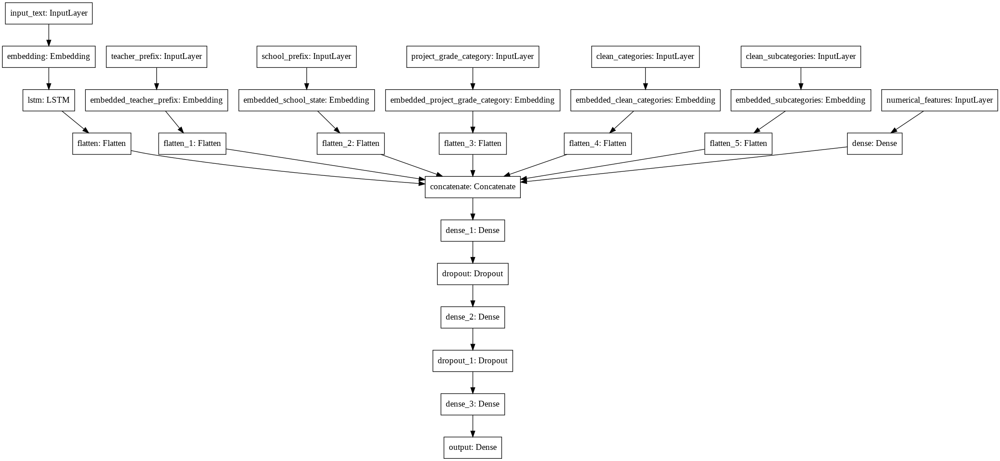

In [ ]:
#drawing models
tf.keras.utils.plot_model(
    model_2,
    show_shapes=False,
    show_layer_names=True,
    rankdir='TB',
    expand_nested=False,
    dpi=96
)

In [ ]:
#model_1.summary()

In [ ]:
train_data_1 = [padded_train,enc_prefix_train,enc_state_train,enc_grade_train,enc_cat_train,enc_subcat_train,normal_train]
test_data_1 = [padded_test,enc_prefix_test,enc_state_test,enc_grade_test,enc_cat_test,enc_subcat_test,normal_test]

In [ ]:
from keras.utils import np_utils
Y_train = np_utils.to_categorical(y_train, 2) 
Y_test = np_utils.to_categorical(y_test, 2)

In [ ]:
def auroc(y_true, y_pred):
  try:
    return tf.py_function(roc_auc_score, (y_true, y_pred), tf.double)
  except ValueError:
    pass

In [ ]:
model_2.compile(optimizer=Adam(lr=0.001), loss='categorical_crossentropy', metrics=[auroc])

In [ ]:
!pip install tensorboardcolab
%load_ext tensorboard

In [ ]:
!rm -rf ./logs/

In [ ]:
from keras.callbacks import TensorBoard

In [ ]:
checkpoint_1 = ModelCheckpoint("model_2.h5",monitor="val_auroc",mode="max",save_best_only = True,verbose=1)
NAME = 'model_2'
tensorboard_1 = TensorBoard(log_dir='logsv\{}'.format(NAME),update_freq='epoch')
earlystop = EarlyStopping(monitor='val_auroc', min_delta=0, patience=2, verbose=1, mode='max')

# logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
# tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
# print(logdir)

callbacks_1 = [tensorboard_1, checkpoint_1, earlystop]

In [ ]:
history_1 = model_2.fit(train_data_1,Y_train,batch_size=512,epochs=20,validation_data=(test_data_1,Y_test),verbose=1, callbacks=callbacks_1)

Epoch 1/20
  1/161 [..............................] - ETA: 0s - loss: 2.1636 - auroc: 0.5323WARNING:tensorflow:From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/summary_ops_v2.py:1277: stop (from tensorflow.python.eager.profiler) is deprecated and will be removed after 2020-07-01.
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
161/161 [==============================] - ETA: 0s - loss: 1.0609 - auroc: 0.6542
Epoch 00001: val_auroc improved from -inf to 0.70420, saving model to model_2.h5
161/161 [==============================] - 472s 3s/step - loss: 1.0609 - auroc: 0.6542 - val_loss: 0.7827 - val_auroc: 0.7042
Epoch 2/20
161/161 [==============================] - ETA: 0s - loss: 0.6493 - auroc: 0.6870
Epoch 00002: val_auroc improved from 0.70420 to 0.70569, saving model to model_2.h5
161/161 [==============================] - 459s 3s/step - loss: 0.6493 - auroc: 0.6870 - val_loss: 0.5853 - val_auroc: 0.7057
Epoch 3/20
161/161 [==================

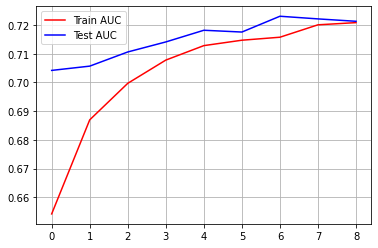

In [ ]:
plt.plot(history_1.history['auroc'], 'r')
plt.plot(history_1.history['val_auroc'], 'b')
plt.legend({'Train AUC': 'r', 'Test AUC':'b'})
plt.grid()
plt.show()

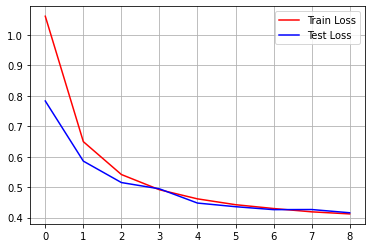

In [ ]:
plt.plot(history_1.history['loss'], 'r')
plt.plot(history_1.history['val_loss'], 'b')
plt.legend({'Train Loss': 'r', 'Test Loss':'b'})
plt.grid()
plt.show()

In [ ]:
!ls

 adc.json	  model_2.h5		  resources.csv
 glove_vectors	  model.png		  sample_data
'logsv\model_2'   preprocessed_data.csv   train_data.csv


In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
NAME = model_2
%tensorboard --logdir='/content/logsv\model_2/' 

<IPython.core.display.Javascript object>

In [ ]:
!kill 1650

### Model 2 - Plots

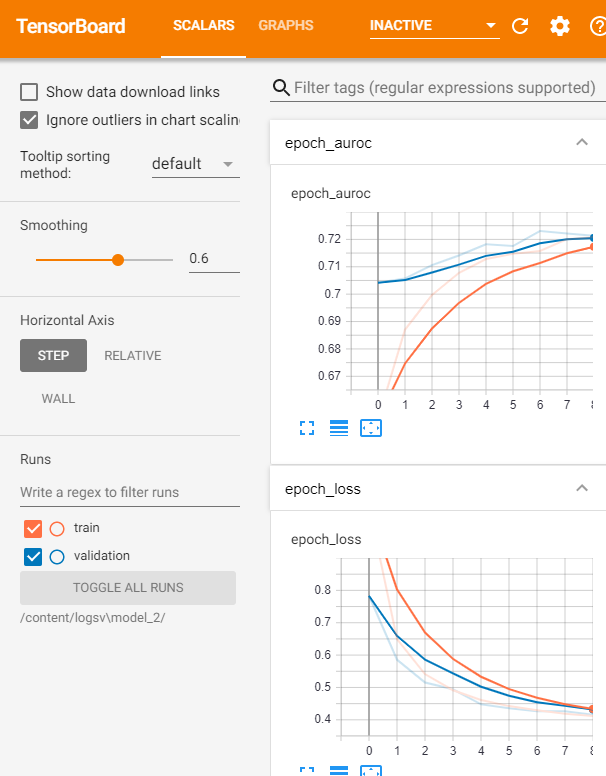

# Model 3

## Encoding Text Data - Essay

In [ ]:
#tokenizer keras : https://stackoverflow.com/a/51956230
from keras.preprocessing.text import Tokenizer
tokenizer = Tokenizer()
tokenizer.fit_on_texts(X_train["essay"].tolist())
seq_train = tokenizer.texts_to_sequences(X_train["essay"])
seq_test = tokenizer.texts_to_sequences(X_test["essay"])

In [ ]:
#https://learn-neural-networks.com/world-embedding-by-keras/
vocab_size = len(tokenizer.word_index) + 1
vocab_size

50433

In [ ]:
#Post Padding to make the input to the fisrt layer of same length
from keras.preprocessing.sequence import pad_sequences
padded_train = pad_sequences(seq_train,maxlen=800,padding='post', truncating='post')
padded_test = pad_sequences(seq_test, maxlen=800,padding='post', truncating='post')

In [ ]:
glove_vector = open("/content/glove_vectors","rb")
glove_vectors = pickle.load(glove_vector)

In [ ]:
embedding_matrix = np.zeros((vocab_size, 300))
for word, i in tokenizer.word_index.items():
    embedding_vector = glove_vectors.get(word)
    if embedding_vector is not None:
        embedding_matrix[i] = embedding_vector

In [ ]:
embedding_matrix.shape

(50433, 300)

<h2>1.4 Make Data Model Ready: encoding numerical, categorical features</h2>

In [ ]:
# please write all the code with proper documentation, and proper titles for each subsection
# go through documentations and blogs before you start coding 
# first figure out what to do, and then think about how to do.
# reading and understanding error messages will be very much helpfull in debugging your code
# make sure you featurize train and test data separatly

# when you plot any graph make sure you use 
    # a. Title, that describes your plot, this will be very helpful to the reader
    # b. Legends if needed
    # c. X-axis label
    # d. Y-axis label

# 1.4.1 encoding categorical features: School State

In [ ]:
#Taken from 5_Reference_SampleSolution.ipynb

vectorizer = CountVectorizer()
vectorizer.fit(X_train['school_state'].values) # fit has to happen only on train data

# we use the fitted CountVectorizer to convert the text to vector
X_train_state_ohe = vectorizer.transform(X_train['school_state'].values)
#X_cv_state_ohe = vectorizer.transform(X_cv['school_state'].values)
X_test_state_ohe = vectorizer.transform(X_test['school_state'].values)

print("After vectorizations")
print(X_train_state_ohe.shape, y_train.shape)
#print(X_cv_state_ohe.shape, y_cv.shape)
print(X_test_state_ohe.shape, y_test.shape)
# print(vectorizer.get_feature_names())
print("="*100)

# #Storing feature names in a list
# feature_names.extend(vectorizer.get_feature_names())
# print ("feature names list length = ",len(feature_names))
# #print ("\nHere :",(feature_names))

After vectorizations
(81936, 51) (81936,)
(27312, 51) (27312,)


# 1.4.2 encoding categorical features: teacher_prefix

In [ ]:
#Taken from 5_Reference_SampleSolution.ipynb

vectorizer = CountVectorizer()
vectorizer.fit(X_train['teacher_prefix'].values) # fit has to happen only on train data

# we use the fitted CountVectorizer to convert the text to vector
X_train_teacher_ohe = vectorizer.transform(X_train['teacher_prefix'].values)
#X_cv_teacher_ohe = vectorizer.transform(X_cv['teacher_prefix'].values)
X_test_teacher_ohe = vectorizer.transform(X_test['teacher_prefix'].values)

print("After vectorizations")
print(X_train_teacher_ohe.shape, y_train.shape)
#print(X_cv_teacher_ohe.shape, y_cv.shape)
print(X_test_teacher_ohe.shape, y_test.shape)
# print(vectorizer.get_feature_names())
print("="*100)

# #Storing feature names in a list
# feature_names.extend(vectorizer.get_feature_names())
# print ("feature names list length = ",len(feature_names))
# #print ("\nHere :",(feature_names))

After vectorizations
(81936, 5) (81936,)
(27312, 5) (27312,)


# 1.4.3 encoding categorical features: project_grade_category

In [ ]:
#Taken from 5_Reference_SampleSolution.ipynb

vectorizer = CountVectorizer()
vectorizer.fit(X_train['project_grade_category'].values) # fit has to happen only on train data

# we use the fitted CountVectorizer to convert the text to vector
X_train_grade_ohe = vectorizer.transform(X_train['project_grade_category'].values)
#X_cv_grade_ohe = vectorizer.transform(X_cv['project_grade_category'].values)
X_test_grade_ohe = vectorizer.transform(X_test['project_grade_category'].values)

print("After vectorizations")
print(X_train_grade_ohe.shape, y_train.shape)
#print(X_cv_grade_ohe.shape, y_cv.shape)
print(X_test_grade_ohe.shape, y_test.shape)
# print(vectorizer.get_feature_names())
print("="*100)

# #Storing feature names in a list
# feature_names.extend(vectorizer.get_feature_names())
# print ("feature names list length = ",len(feature_names))
# #print ("\nHere :",(feature_names))

After vectorizations
(81936, 4) (81936,)
(27312, 4) (27312,)


# 1.4.4 encoding categorical features: clean_categories

In [ ]:
#Referred from 5_Reference_SampleSolution.ipynb

vectorizer = CountVectorizer()
vectorizer.fit(X_train['clean_categories'].values) # fit has to happen only on train data

# we use the fitted CountVectorizer to convert the text to vector
X_train_clean_categories_ohe = vectorizer.transform(X_train['clean_categories'].values)
#X_cv_clean_categories_ohe = vectorizer.transform(X_cv['clean_categories'].values)
X_test_clean_categories_ohe = vectorizer.transform(X_test['clean_categories'].values)

print("After vectorizations")
print(X_train_clean_categories_ohe.shape, y_train.shape)
#print(X_cv_clean_categories_ohe.shape, y_cv.shape)
print(X_test_clean_categories_ohe.shape, y_test.shape)
# print(vectorizer.get_feature_names())
print("="*100)

# #Storing feature names in a list
# feature_names.extend(vectorizer.get_feature_names())
# print ("feature names list length = ",len(feature_names))
# #print ("\nHere :",(feature_names))

After vectorizations
(81936, 9) (81936,)
(27312, 9) (27312,)


# 1.4.5 encoding categorical features: clean_subcategories

In [ ]:
#Referred from 5_Reference_SampleSolution.ipynb

vectorizer = CountVectorizer()
vectorizer.fit(X_train['clean_subcategories'].values) # fit has to happen only on train data

# we use the fitted CountVectorizer to convert the text to vector
X_train_clean_subcategories_ohe = vectorizer.transform(X_train['clean_subcategories'].values)
#X_cv_clean_subcategories_ohe = vectorizer.transform(X_cv['clean_subcategories'].values)
X_test_clean_subcategories_ohe = vectorizer.transform(X_test['clean_subcategories'].values)

print("After vectorizations")
print(X_train_clean_subcategories_ohe.shape, y_train.shape)
#print(X_cv_clean_subcategories_ohe.shape, y_cv.shape)
print(X_test_clean_subcategories_ohe.shape, y_test.shape)
# print(vectorizer.get_feature_names())
print("="*100)

# #Storing feature names in a list
# feature_names.extend(vectorizer.get_feature_names())
# print ("feature names list length = ",len(feature_names))
# #print ("\nHere :",(feature_names))

After vectorizations
(81936, 30) (81936,)
(27312, 30) (27312,)


# 1.4.6 encoding numerical features: Price

In [ ]:
#Taken from 5_Reference_SampleSolution.ipynb

from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X_train['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['price'].values.reshape(1,-1))

X_train_price_norm = normalizer.transform(X_train['price'].values.reshape(1,-1))
#X_cv_price_norm = normalizer.transform(X_cv['price'].values.reshape(1,-1))
X_test_price_norm = normalizer.transform(X_test['price'].values.reshape(1,-1))

X_train_price_norm = X_train_price_norm.reshape(-1,1)
#X_cv_price_norm = X_cv_price_norm.reshape(-1,1)
X_test_price_norm = X_test_price_norm.reshape(-1,1)

print("After vectorizations")
print(X_train_price_norm.shape, y_train.shape)
#print(X_cv_price_norm.shape, y_cv.shape)
print(X_test_price_norm.shape, y_test.shape)
print("="*100)

# #Storing feature names in a list
# feature_names.append('Numerical_R_Price')
# print ("feature names list length = ",len(feature_names))
# #print ("\nHere :",(feature_names))

print("="*100)
#printing price after normalization
print(X_train_price_norm[0:10])

After vectorizations
(81936, 1) (81936,)
(27312, 1) (27312,)
[[3.68558063e-03]
 [4.01821584e-05]
 [1.45386355e-03]
 [4.42164471e-03]
 [3.29230689e-03]
 [8.04519870e-04]
 [1.14701798e-03]
 [6.97123919e-04]
 [6.20266409e-05]
 [3.49950071e-03]]


# 1.4.7 encoding numerical features: teacher_number_of_previously_posted_projects

In [ ]:
#Referred from 5_Reference_SampleSolution.ipynb

from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X_train['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))

X_train_prevProjects_norm = normalizer.transform(X_train['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))
#X_cv_prevProjects_norm = normalizer.transform(X_cv['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))
X_test_prevProjects_norm = normalizer.transform(X_test['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))

X_train_prevProjects_norm = X_train_prevProjects_norm.reshape(-1,1)
#X_cv_prevProjects_norm = X_cv_prevProjects_norm.reshape(-1,1)
X_test_prevProjects_norm = X_test_prevProjects_norm.reshape(-1,1)

print("After vectorizations")
print(X_train_prevProjects_norm.shape, y_train.shape)
#print(X_cv_prevProjects_norm.shape, y_cv.shape)
print(X_test_prevProjects_norm.shape, y_test.shape)
print("="*100)

# #Storing feature names in a list
# feature_names.append('Numerical_Prev_Projects')
# print ("feature names list length = ",len(feature_names))
# #print ("\nHere :",(feature_names))

print("="*100)
#printing prevProjects after normalization
print(X_train_prevProjects_norm[0:10])

After vectorizations
(81936, 1) (81936,)
(27312, 1) (27312,)
[[0.00023512]
 [0.00082292]
 [0.00023512]
 [0.00023512]
 [0.00658338]
 [0.00517266]
 [0.00105804]
 [0.00047024]
 [0.0044673 ]
 [0.        ]]


# 1.4.7 encoding numerical features: quantity

In [ ]:
#Referred from 5_Reference_SampleSolution.ipynb

from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X_train['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['quantity'].values.reshape(1,-1))

X_train_quantity_norm = normalizer.transform(X_train['quantity'].values.reshape(1,-1))
#X_cv_prevProjects_norm = normalizer.transform(X_cv['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))
X_test_quantity_norm = normalizer.transform(X_test['quantity'].values.reshape(1,-1))

X_train_quantity_norm = X_train_quantity_norm.reshape(-1,1)
#X_cv_prevProjects_norm = X_cv_prevProjects_norm.reshape(-1,1)
X_test_quantity_norm = X_test_quantity_norm.reshape(-1,1)

print("After vectorizations")
print(X_train_quantity_norm.shape, y_train.shape)
#print(X_cv_prevProjects_norm.shape, y_cv.shape)
print(X_test_quantity_norm.shape, y_test.shape)
print("="*100)

# #Storing feature names in a list
# feature_names.append('Numerical_Prev_Projects')
# print ("feature names list length = ",len(feature_names))
# #print ("\nHere :",(feature_names))

print("="*100)
#printing prevProjects after normalization
print(X_train_quantity_norm[0:10])

After vectorizations
(81936, 1) (81936,)
(27312, 1) (27312,)
[[0.00011265]
 [0.00056325]
 [0.0006759 ]
 [0.0013518 ]
 [0.00033795]
 [0.0020277 ]
 [0.00056325]
 [0.00011265]
 [0.0013518 ]
 [0.0004506 ]]


### **Numerical Features - Quantity, Prev. Projects, & Price**

### *Cocatenating Numerical Features*

In [ ]:
numerical_train = np.concatenate((X_train_price_norm,X_train_quantity_norm,X_train_prevProjects_norm),axis=1)
numerical_test = np.concatenate((X_test_price_norm,X_test_quantity_norm,X_test_prevProjects_norm),axis=1)

from sklearn.preprocessing import StandardScaler
Std_Scale = StandardScaler()
normal_train = Std_Scale.fit_transform(numerical_train)
normal_test = Std_Scale.transform(numerical_test)

# 1.4.8.1 Concatinating all the features - Categorical and Numerical

In [ ]:
from scipy.sparse import hstack
ohe_cat_train = hstack([X_train_state_ohe, X_train_teacher_ohe, X_train_grade_ohe, X_train_clean_categories_ohe, X_train_clean_subcategories_ohe]).todense()
ohe_cat_test = hstack([X_test_state_ohe, X_test_teacher_ohe, X_test_grade_ohe, X_test_clean_categories_ohe, X_test_clean_subcategories_ohe]).todense()
ohe_all_train = np.hstack((ohe_cat_train,normal_train))
ohe_all_test = np.hstack((ohe_cat_test,normal_test))
ohe_train = np.expand_dims(ohe_all_train,2)
ohe_test = np.expand_dims(ohe_all_test,2)

In [ ]:
ohe_train.shape, ohe_test.shape

((81936, 102, 1), (27312, 102, 1))

### **LSTM Connection for Text Data**

In [ ]:
#Source: https://github.com/vishnurapps/LSTM-on-Donors-Choose

In [ ]:
#https://stats.stackexchange.com/a/305032
input_text = Input(shape=(800,),name="input_text")
embed_out = Embedding(vocab_size,300,weights=[embedding_matrix],input_length=800,trainable=False)(input_text)
lstm_out = LSTM(256,recurrent_dropout=0.5,kernel_regularizer=regularizers.l2(0.001),return_sequences=True)(embed_out)
flat_out = Flatten()(lstm_out)

### CNN for Concatenated Rest of the Features

In [ ]:
inp_conv=Input(shape=(102, 1))
x1 = Conv1D(filters=128, kernel_size=3, activation='relu',kernel_initializer="he_normal")(inp_conv)
#x1 = Conv1D(filters=128, kernel_size=3, activation='relu',kernel_initializer="he_normal")(x1)
x1 = Conv1D(filters=128, kernel_size=3, activation='relu',kernel_initializer="he_normal")(x1)
x1 = Flatten()(x1)

### Connecting Both LSTM and CNN Models

In [ ]:
x_concatenate = concatenate([flat_out,x1])
x = Dense(128,activation="relu",kernel_initializer="he_normal",kernel_regularizer=regularizers.l2(0.001))(x_concatenate)
x=Dropout(0.5)(x)
x = Dense(64,activation="relu",kernel_initializer="he_normal",kernel_regularizer=regularizers.l2(0.001))(x)
x=Dropout(0.3)(x)
x = Dense(32,activation="relu",kernel_initializer="he_normal",kernel_regularizer=regularizers.l2(0.001))(x)
output = Dense(2, activation='softmax', name='output')(x)
model_3 = Model(inputs=[input_text,inp_conv],outputs=[output])

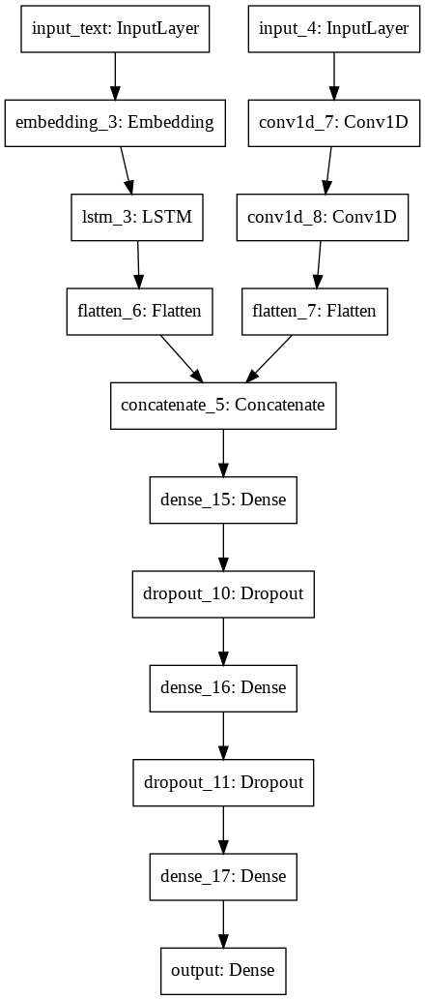

In [ ]:
#drawing models
tf.keras.utils.plot_model(
    model_3,
    show_shapes=False,
    show_layer_names=True,
    rankdir='TB',
    expand_nested=False,
    dpi=96
)

In [ ]:
train_data_3 = [padded_train,ohe_train]
test_data_3 = [padded_test,ohe_test]

In [ ]:
from keras.utils import np_utils
Y_train = np_utils.to_categorical(y_train, 2) 
Y_test = np_utils.to_categorical(y_test, 2)

In [ ]:
def auc1(y_true, y_pred):
    if len(np.unique(y_true[:,1])) == 1:
        return 0.5
    else:
        return roc_auc_score(y_true, y_pred)
def auroc(y_true, y_pred):
    return tf.py_function(auc1, (y_true, y_pred), tf.double)

In [ ]:
model_3.compile(optimizer=Adam(lr=0.001), loss='categorical_crossentropy', metrics=[auroc])

In [ ]:
!pip install tensorboardcolab
%load_ext tensorboard

In [ ]:
!rm -rf ./logs/

In [ ]:
from keras.callbacks import TensorBoard

In [ ]:
checkpoint_1 = ModelCheckpoint("model_3.h5",monitor="val_auroc",mode="max",save_best_only = True,verbose=1)
NAME = 'model_3'
tensorboard_1 = TensorBoard(log_dir='logsv\{}'.format(NAME),update_freq='epoch')
earlystop = EarlyStopping(monitor='val_auroc', min_delta=0, patience=2, verbose=1, mode='max')

# logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
# tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
# print(logdir)

callbacks_1 = [tensorboard_1, checkpoint_1, earlystop]

In [ ]:
history_1 = model_3.fit(train_data_3,Y_train,batch_size=512,epochs=20,validation_data=(test_data_3,Y_test),verbose=1, callbacks=callbacks_1)

Epoch 1/20
161/161 [==============================] - ETA: 0s - loss: 0.4634 - auroc: 0.7403
Epoch 00001: val_auroc improved from -inf to 0.75431, saving model to model_3.h5
161/161 [==============================] - 427s 3s/step - loss: 0.4634 - auroc: 0.7403 - val_loss: 0.5047 - val_auroc: 0.7543
Epoch 2/20
161/161 [==============================] - ETA: 0s - loss: 0.4317 - auroc: 0.7460
Epoch 00002: val_auroc improved from 0.75431 to 0.76145, saving model to model_3.h5
161/161 [==============================] - 411s 3s/step - loss: 0.4317 - auroc: 0.7460 - val_loss: 0.4374 - val_auroc: 0.7615
Epoch 3/20
161/161 [==============================] - ETA: 0s - loss: 0.4109 - auroc: 0.7522
Epoch 00003: val_auroc improved from 0.76145 to 0.76316, saving model to model_3.h5
161/161 [==============================] - 411s 3s/step - loss: 0.4109 - auroc: 0.7522 - val_loss: 0.4145 - val_auroc: 0.7632
Epoch 4/20
161/161 [==============================] - ETA: 0s - loss: 0.4051 - auroc: 0.7551
E

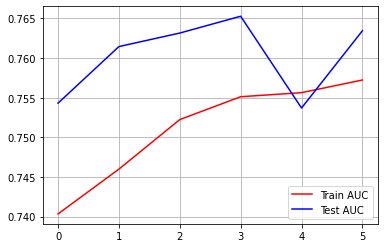

In [ ]:
plt.plot(history_1.history['auroc'], 'r')
plt.plot(history_1.history['val_auroc'], 'b')
plt.legend({'Train AUC': 'r', 'Test AUC':'b'})
plt.grid()
plt.show()

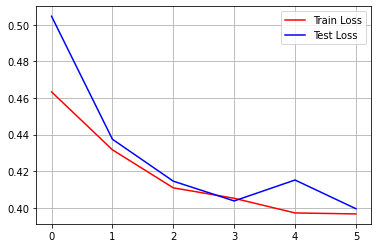

In [ ]:
plt.plot(history_1.history['loss'], 'r')
plt.plot(history_1.history['val_loss'], 'b')
plt.legend({'Train Loss': 'r', 'Test Loss':'b'})
plt.grid()
plt.show()

In [ ]:
!ls

 adc.json	  model_3.h5		  resources.csv
 glove_vectors	  model.png		  sample_data
'logsv\model_3'   preprocessed_data.csv   train_data.csv


In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
NAME = model_3
%tensorboard --logdir='/content/logsv\model_3/'

<IPython.core.display.Javascript object>

In [ ]:
!kill 1650

### Model 3 - Plots

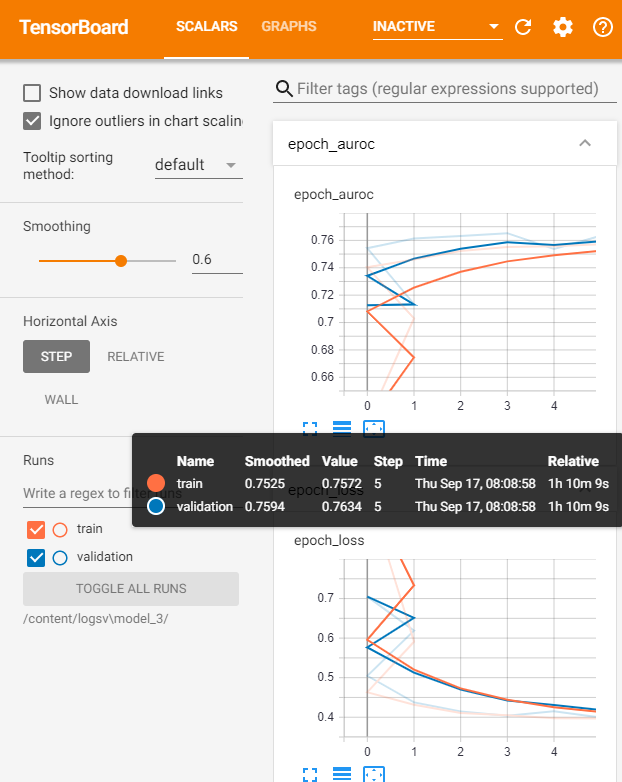